# Reinforcement Learning: DQN

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, DQN.py, replay_buffer.py, and env_wrapper.py.

To avoid pain with installation and model training, please use Colab for this project. DO NOT use Windows for this project. If you use Mac, there might be some potential test case failures you need to address with extra effort.

## Set up

In [ ]:
# !git clone https://github.com/kbaseba/239AS_2.git

Cloning into '239AS_2'...
remote: Enumerating objects: 360, done.
remote: Total 360 (delta 0), reused 0 (delta 0), pack-reused 360 (from 2)
Receiving objects: 100% (360/360), 865.41 MiB | 15.48 MiB/s, done.
Resolving deltas: 100% (114/114), done.
Updating files: 100% (163/163), done.


In [ ]:
# mount it if you use Colab
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# TODO: change the dir to your folder
# %cd /content/239AS_2/Project_4/

/content/239AS_2/Project_4


In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!pip install numpy torch wandb swig matplotlib termcolor
!pip install gymnasium
!pip install gymnasium[box2d]

In [2]:
import rl_test
from utils import *

## Introduction to the Enviroment (5 points)
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [3]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v3', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

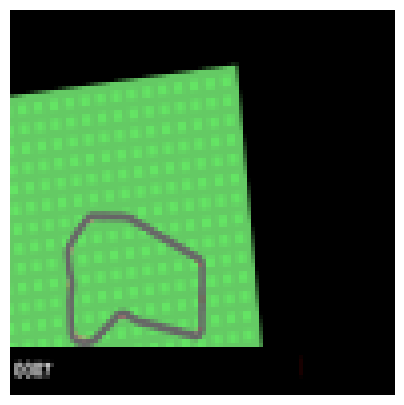

In [13]:
from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break

anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation.

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.

### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [4]:
from env_wrapper import EnvWrapper

rl_test.test_wrapper(EnvWrapper)

Passed reset
Passed step


## DQN (25 points)

### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper
`MLP` class.

In [5]:
import model
rl_test.test_model_DQN(model.Nature_Paper_Conv)

Passed


Now we are ready to implement the DQN algorithm.

![title](https://github.com/kbaseba/239AS_2/blob/main/Project_4/DQN.png?raw=1)

### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `replay_buffer.py`. This buffer will store the transitions of the agent and sample them for training.

In [6]:
from replay_buffer import ReplayBufferDQN

rl_test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



### DQN (15 points)
Now implement the `_optimize_model` and `_sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `_sample_action` function will sample an action from the model given the current state. Train the model over 200 episdoes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [7]:
import wandb

In [8]:
wandb.login()

wandb: Currently logged in as: kbaseba (kbaseba-ucla) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [9]:
wandb.init(project="racing-car-dqn")

In [11]:
import DQN
import utils
import torch

# if running with Colab T4 with wandb, it takes 60-70 mins
# if running with Colab T4 w/o wandb, it takes ~30 mins
# your test mean reward idealy should be larger than 400
trainerDQN = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700, 0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

trainerDQN.train(200, 50, 30, 50, 50)



saving to ./runs/DQN/run0


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


Episode: 0: Time: 6.133239984512329 Total Reward: -12.26618705035983 Avg_Loss: 0.0
Episode: 1: Time: 8.21942663192749 Total Reward: -62.948717948718894 Avg_Loss: 0.9044264260750667
Episode: 2: Time: 8.034026622772217 Total Reward: -32.95620437956208 Avg_Loss: 0.855911413692877
Episode: 3: Time: 8.44169282913208 Total Reward: -73.57142857142873 Avg_Loss: 0.825164575834109
Episode: 4: Time: 8.884541988372803 Total Reward: -20.925925925926414 Avg_Loss: 0.7258721724731707
Episode: 5: Time: 8.549166917800903 Total Reward: -38.66197183098643 Avg_Loss: 0.9092964216628495
Episode: 6: Time: 8.060179948806763 Total Reward: -18.66412213740521 Avg_Loss: 0.7732668172787217
Episode: 7: Time: 8.099495649337769 Total Reward: 14.375000000001073 Avg_Loss: 1.035137609085616
Episode: 8: Time: 8.225048780441284 Total Reward: 28.188405797103286 Avg_Loss: 1.4093751558924423
Episode: 9: Time: 8.339138507843018 Total Reward: 75.4545454545497 Avg_Loss: 1.1264866085237815
Episode: 10: Time: 8.327865362167358 Tot

Please include a plot of the training and validation rewards over the episodes in the report. Anwer the question in no more than 2 sentences: Does the loss matter in DQN? Why or why not?

Your answer:

Certainly, loss has significance in DQN as it helps the Q-network converge towards the optimal action-value function by reducing the error associated with predicted and target Q-values. Nevertheless, performance isn’t always strong when loss is low, as that low loss may not indicate how well the learned policy performs within the environment. loss !(always)= good policy - since overfitting or poor exploration can lead to low loss but suboptimal actions.

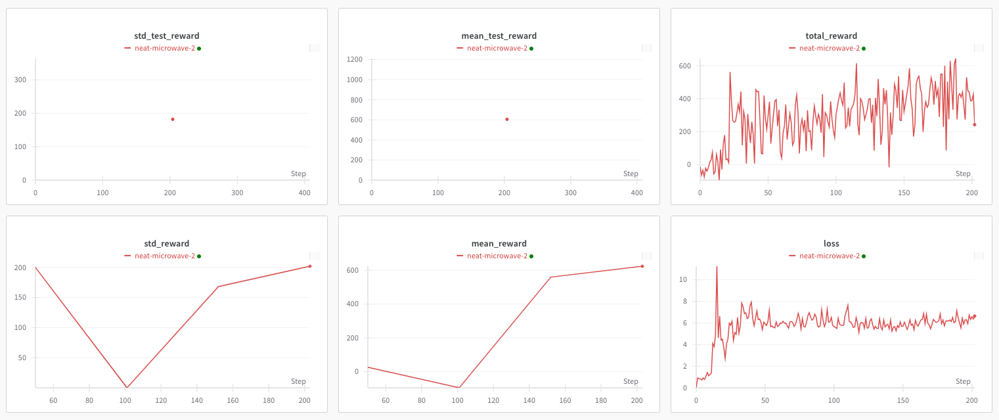

In [17]:
from IPython.display import Image, display
import os

img_path = os.path.join('.', 'images', 'dqn_stats.png')
display(Image(filename=img_path))

#### Animation

We can also draw a animation of the car in one game, the code is provided below. The animation is just for your reference to get a feeling of how good your model is. No need to submit in your submission. We will grade based on your plots of training and validation above.

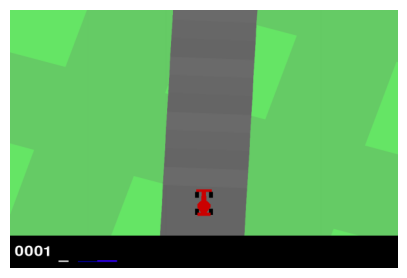

In [14]:
eval_env = gym.make('CarRacing-v3', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

## Double DQN (10 points)
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.

### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.

In [15]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates/run0


loss,▁▁▂▂▄▅▆▅█▇▆▆▆▆▇▇▆▆▆▇▇▆▆▆▆▆▇▆▆▆▆▇▇▆▆▆▇█▆▇
mean_reward,▂▁▇█
mean_test_reward,▁
std_reward,█▁▇█
std_test_reward,▁
total_reward,▁▁▃▁▄▆▄▂▄▄▄▄▃▄▄▆▅▅▄▄▄▃▅▄▆█▄▆▅▃▆▄▆▅▅▇▄▅▅▆
loss,6.63542
mean_reward,623.80108
mean_test_reward,605.07715
std_reward,201.97061
std_test_reward,181.98731


Episode: 0: Time: 6.266873121261597 Total Reward: -75.32786885245906 Avg_Loss: 0.0
Episode: 1: Time: 7.877405643463135 Total Reward: -27.65993265993273 Avg_Loss: 0.5757119180456658
Episode: 2: Time: 8.303340673446655 Total Reward: -49.38596491228109 Avg_Loss: 0.6556620778468978
Episode: 3: Time: 8.493849039077759 Total Reward: -25.379746835443456 Avg_Loss: 0.669369897891243
Episode: 4: Time: 8.35913872718811 Total Reward: -30.593220338983627 Avg_Loss: 0.7232532752912586
Episode: 5: Time: 8.36700439453125 Total Reward: -60.18987341772223 Avg_Loss: 0.6708114022279487
Episode: 6: Time: 8.604320049285889 Total Reward: -48.55191256830665 Avg_Loss: 0.6209662687502989
Episode: 7: Time: 8.404366254806519 Total Reward: -40.945945945946264 Avg_Loss: 0.5619077489030462
Episode: 8: Time: 8.311173677444458 Total Reward: -36.60583941605904 Avg_Loss: 0.5841519497334957
Episode: 9: Time: 8.698513507843018 Total Reward: 106.29870129870064 Avg_Loss: 0.6069765026767214
Episode: 10: Time: 8.37355804443359

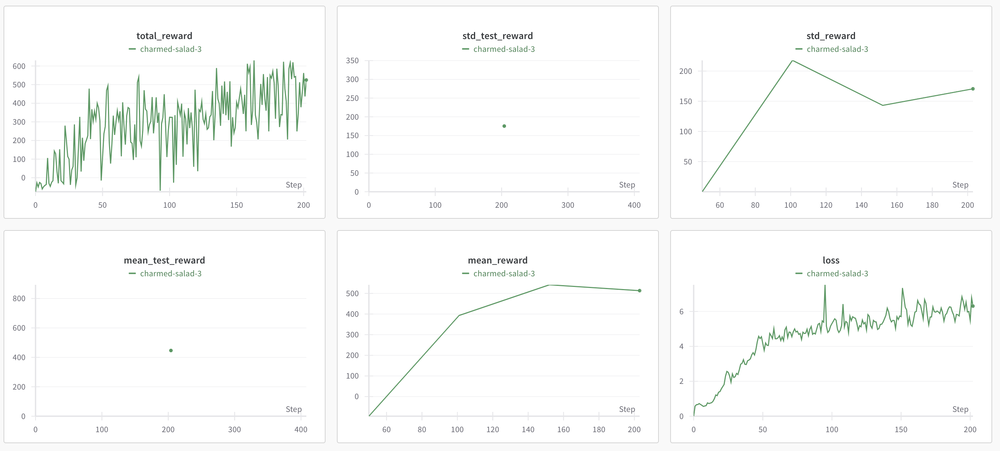

In [3]:
img_path = os.path.join('.', 'images', 'hard_dqn_stats.png')
display(Image(filename=img_path))

#### Animation

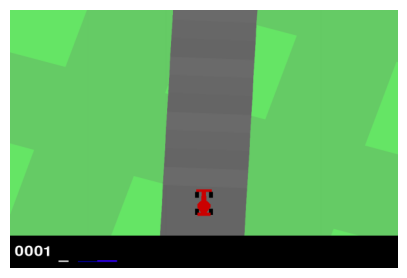

In [16]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [10]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates/run0


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


Episode: 0: Time: 6.359175682067871 Total Reward: -33.848920863309544 Avg_Loss: 0.0
Episode: 1: Time: 8.767962455749512 Total Reward: -46.92307692307715 Avg_Loss: 0.7833606781331217
Episode: 2: Time: 9.387411832809448 Total Reward: -29.306569343066098 Avg_Loss: 0.7772658258488699
Episode: 3: Time: 9.651671171188354 Total Reward: -48.57142857142889 Avg_Loss: 0.8115668516574788
Episode: 4: Time: 10.046218395233154 Total Reward: -20.92592592592637 Avg_Loss: 0.7559677272909829
Episode: 5: Time: 10.012659072875977 Total Reward: -77.39436619718307 Avg_Loss: 0.7192318934728118
Episode: 6: Time: 9.452333211898804 Total Reward: -14.84732824427546 Avg_Loss: 0.7523773938980924
Episode: 7: Time: 9.38041639328003 Total Reward: -63.750000000000554 Avg_Loss: 0.7029306743638355
Episode: 8: Time: 9.65608549118042 Total Reward: -62.39130434782662 Avg_Loss: 0.6861154307149538
Episode: 9: Time: 9.332027673721313 Total Reward: -38.18181818181847 Avg_Loss: 0.7263028417565242
Episode: 10: Time: 9.82941913604

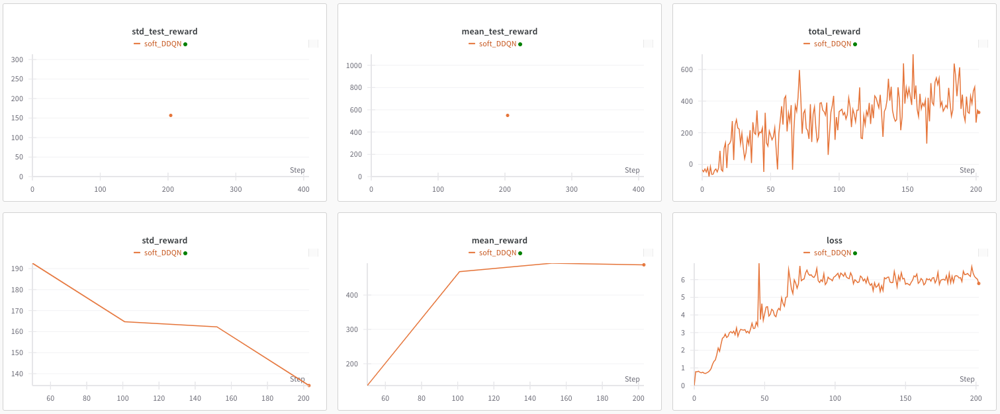

In [13]:
img_path = os.path.join('.', 'images', 'soft_dqn_stats.png')
display(Image(filename=img_path))

#### Animation

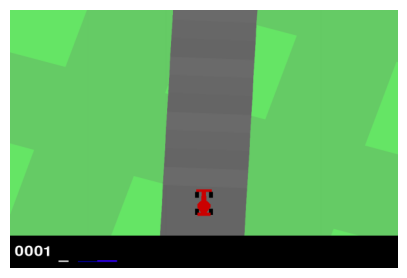

In [14]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

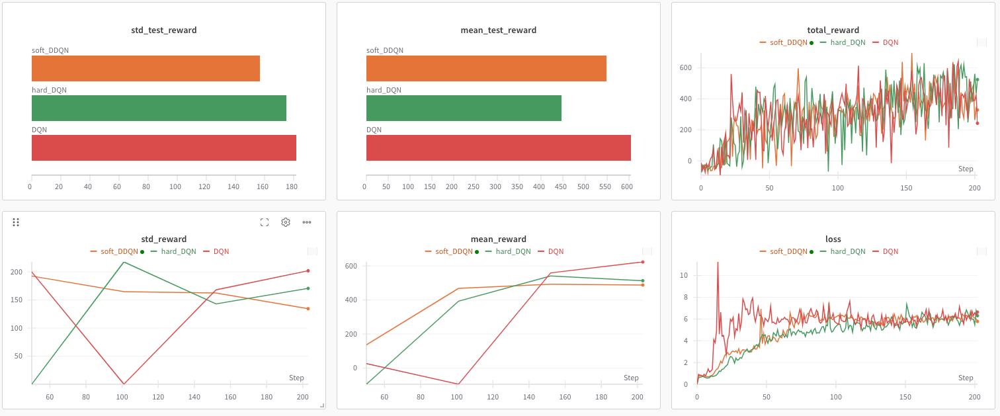

In [15]:
img_path = os.path.join('.', 'images', 'results_summary.png')
display(Image(filename=img_path))

#### base_DQN:
**Validation Mean Reward:** 623.8010792168969 **Validation Std Reward:** 201.97060741012447
**Test Mean Reward:** 605.0771519145571 **Test Std Reward:** 181.9873134653002

#### hard_update_DQN:
**Validation Mean Reward:** 513.33562338453 **Validation Std Reward:** 170.58048857484997
**Test Mean Reward:** 446.53865528587494 **Test Std Reward:** 175.3391396087704

#### soft_update_DQN:
**Validation Mean Reward:** 487.9650956245007 **Validation Std Reward:** 134.3409266799912
**Test Mean Reward:** 549.5277772028743 **Test Std Reward:** 156.81387356367148

## Questions (10 points)
- Which method performed better? (5 points)

Your answer:

- Best overall was the base_DQN which had the highest test mean reward (605.08) albeit with somewhat higher variance.
- Among the variants, softupdateDQN performed better than hard updates on both test mean and variance which demonstrates more stable performance.


- If we modify the $\tau$ for soft updates **or** the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)

Your answer:

Intuition:

| Update Type | Param  | Small Value Effect | Large Value Effect | Paper Implication            |
| ----------- | ------ | ------------------ | ------------------ | ---------------------------- |
| Hard        | $C$    | Fast, unstable     | Stable, slow       | Used large $C$ for stability |
| Soft        | $\tau$ | Stable, slow       | Fast, unstable     | Not used, but similar idea   |

From experiments (C sweep summary - hard update DQN):

| Param   | mean\_test\_reward | std\_test\_reward | Notes                     |
| ------- | ------------------ | ----------------- | ------------------------- |
| C = 20  | **Highest**        | **Highest**       | Learns fast, but volatile |
| C = 100 | Moderate           | Moderate          | Balanced, stable learning |
| C = 500 | Slightly worse     | Lower std         | More stable but slower    |

From experiments (Tau sweep summary - hard update DQN):

| Param     | mean\_test\_reward          | std\_test\_reward | Notes                           |
| --------- | --------------------------- | ----------------- | ------------------------------- |
| τ = 0.05  | **Highest**                 | Moderate          | Fast learning, decent stability |
| τ = 0.01  | Lower                       | Lowest            | Conservative blending           |
| τ = 0.001 | Slightly better than τ=0.01 | **Highest std**   | Too slow, underreactive         |

Based on these results, our intuition held up:

- Hard update DQN performs best at moderate update frequency (C=100), balancing stability and learning speed; too frequent (C=20) causes instability, while too infrequent (C=500) slows convergence.
- Soft update DQN benefits from higher blending rate (τ=0.05), which accelerates learning without excessive variance; very small τ (e.g., 0.001) leads to sluggish, underresponsive updates.

### Tau Sweep Summary

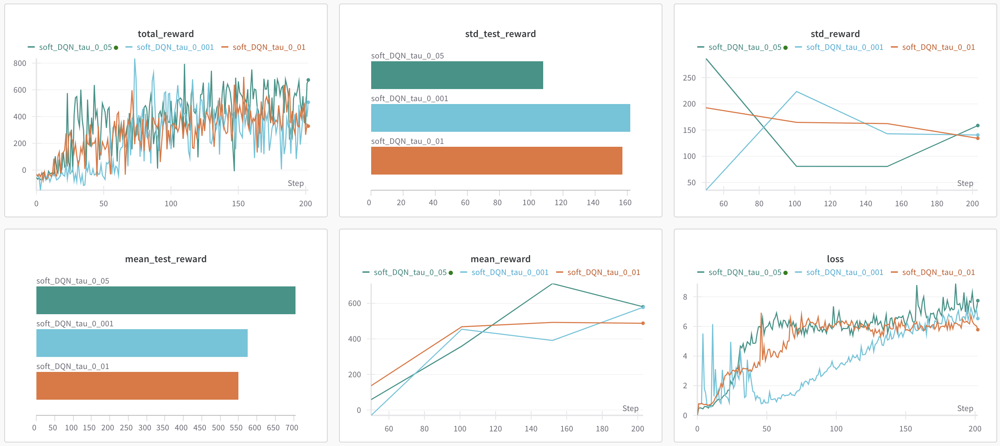

In [18]:
img_path = os.path.join('.', 'images', 'tau_results_summary.png')
display(Image(filename=img_path))

### C Sweep Sumamry

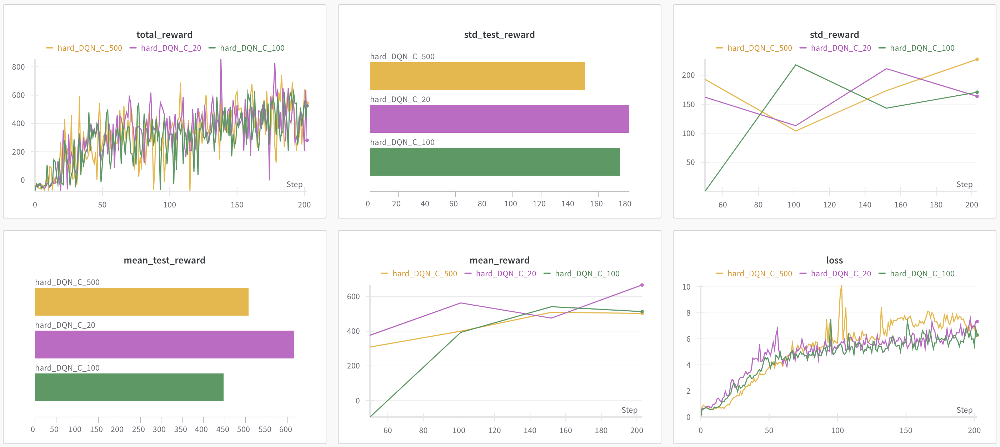

In [19]:
img_path = os.path.join('.', 'images', 'C_results_summary.png')
display(Image(filename=img_path))

In [12]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 20,                          # Change this
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates_test/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates_test/run0


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


Episode: 0: Time: 6.5495007038116455 Total Reward: -62.625899280576135 Avg_Loss: 0.0
Episode: 1: Time: 8.952810287475586 Total Reward: -43.71794871794898 Avg_Loss: 0.655454914732154
Episode: 2: Time: 9.572886228561401 Total Reward: -32.95620437956232 Avg_Loss: 0.6020928432992777
Episode: 3: Time: 9.546243667602539 Total Reward: -41.428571428571615 Avg_Loss: 0.6830792658406646
Episode: 4: Time: 9.807853698730469 Total Reward: -27.65993265993282 Avg_Loss: 0.8070681379685382
Episode: 5: Time: 9.249284267425537 Total Reward: -49.22535211267672 Avg_Loss: 0.7828165134336768
Episode: 6: Time: 8.746994256973267 Total Reward: -45.38167938931362 Avg_Loss: 0.8369419920657363
Episode: 7: Time: 9.633396863937378 Total Reward: -59.843750000000696 Avg_Loss: 0.6991477351666999
Episode: 8: Time: 9.314960956573486 Total Reward: -47.89855072463837 Avg_Loss: 0.7516652555244059
Episode: 9: Time: 8.835227012634277 Total Reward: -23.030303030303724 Avg_Loss: 0.9756142547776719
Episode: 10: Time: 9.2969176769

In [13]:
trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 500,                          # Change this
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates_test/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates_test/run1


loss,▁▁▁▁▁▂▃▃▄▄▅▅▅▆▆▆▄▆▅▆▆▇▆▆▆▇▆▆▆▆▆▆▇▆▇▇▇▇██
mean_reward,▁▅▃█
mean_test_reward,▁
std_reward,▅▁█▅
std_test_reward,▁
total_reward,▁▁▁▃▂▁▅▄▄▅▆▅▅▅▄▅▆▅▇▇▄▄▇▅▆▄▆▇▅▆▇▇▇▆▇▅▆▄▅█
loss,7.32993
mean_reward,667.18845
mean_test_reward,615.0867
std_reward,163.57638
std_test_reward,181.67272


Episode: 0: Time: 6.4389026165008545 Total Reward: -52.031250000000355 Avg_Loss: 0.0
Episode: 1: Time: 8.255250930786133 Total Reward: -31.39575971731456 Avg_Loss: 0.7503820823588568
Episode: 2: Time: 8.446129560470581 Total Reward: -30.018050541516196 Avg_Loss: 0.9030566392701214
Episode: 3: Time: 8.575628519058228 Total Reward: -61.777408637874416 Avg_Loss: 0.7929545947734047
Episode: 4: Time: 8.874367952346802 Total Reward: -62.21311475409895 Avg_Loss: 0.6885187760339815
Episode: 5: Time: 8.308270692825317 Total Reward: -32.69470404984493 Avg_Loss: 0.7193250393322786
Episode: 6: Time: 8.785995721817017 Total Reward: -40.255474452555205 Avg_Loss: 0.6230055453380993
Episode: 7: Time: 8.85183048248291 Total Reward: -76.07255520504734 Avg_Loss: 0.5502683583240048
Episode: 8: Time: 8.453720569610596 Total Reward: -28.333333333333783 Avg_Loss: 0.609753114069585
Episode: 9: Time: 8.93119192123413 Total Reward: 10.431309904152254 Avg_Loss: 0.5872186506088791
Episode: 10: Time: 8.75663661956

In [14]:
traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.001,                                 # Change this
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates_test","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates_test/run0


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


loss,▁▁▁▁▁▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅█▅▅▆▅▅▅▇▆▆▆▆▇▆▆▆▇▇▆
mean_reward,▁▄██
mean_test_reward,▁
std_reward,▆▁▅█
std_test_reward,▁
total_reward,▁▁▁▂▂▂▂▂▄▃▄▄▇▅▇▆▃▃▅▆▆▅▅▅▅▄▆▅▅▅▅▆▇▅█▆▇▅▇▅
loss,6.28228
mean_reward,503.15601
mean_test_reward,506.88677
std_reward,227.35055
std_test_reward,150.87997


Episode: 0: Time: 6.517987012863159 Total Reward: -33.110749185668126 Avg_Loss: 0.0
Episode: 1: Time: 7.89872670173645 Total Reward: -36.37931034482813 Avg_Loss: 0.7851506260455035
Episode: 2: Time: 8.406813859939575 Total Reward: -52.894736842105694 Avg_Loss: 0.7723749261192915
Episode: 3: Time: 7.627444505691528 Total Reward: -150.57936507936546 Avg_Loss: 0.7820082961572944
Episode: 4: Time: 8.5784752368927 Total Reward: -59.70588235294164 Avg_Loss: 5.518818340882533
Episode: 5: Time: 8.780124187469482 Total Reward: -35.74074074074096 Avg_Loss: 1.8013605856015777
Episode: 6: Time: 8.761979818344116 Total Reward: -40.76271186440751 Avg_Loss: 1.4816426527099449
Episode: 7: Time: 8.791294574737549 Total Reward: -74.31034482758632 Avg_Loss: 0.6449806437585033
Episode: 8: Time: 9.162508726119995 Total Reward: -41.02272727272788 Avg_Loss: 0.6105091005657651
Episode: 9: Time: 8.279945373535156 Total Reward: -48.73665480427111 Avg_Loss: 0.5733335452122974
Episode: 10: Time: 4.060454130172729

In [15]:
traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.05,                                 # Change this
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates_test","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates_test/run1


loss,▁▄▂▁▃▄▂▂▄▂▂▁▂▂▂▃▃▃▃▄▄▅▅▆▆▆▇▇▇▇▇▇█▇▇█▇▇██
mean_reward,▁▇▆█
mean_test_reward,▁
std_reward,▁█▅▅
std_test_reward,▁
total_reward,▁▁▁▁▁▁▁▁▂▁▁▂▂▂▂▁▃▂▂█▄▇▃▃▇▆▇▆▄▄▃▅▆▅▅▄▆▃▃▅
loss,6.53101
mean_reward,577.64873
mean_test_reward,574.93943
std_reward,140.61054
std_test_reward,161.74126


Episode: 0: Time: 6.55631422996521 Total Reward: -54.86622073578655 Avg_Loss: 0.0
Episode: 1: Time: 7.581755876541138 Total Reward: -68.28244274809225 Avg_Loss: 0.4865546637914695
Episode: 2: Time: 8.656254053115845 Total Reward: -55.65573770491892 Avg_Loss: 0.5086549636379605
Episode: 3: Time: 8.724108457565308 Total Reward: -71.27118644067843 Avg_Loss: 0.4809999328044032
Episode: 4: Time: 8.742109060287476 Total Reward: -72.1241830065363 Avg_Loss: 0.43843170103984846
Episode: 5: Time: 8.42009162902832 Total Reward: -22.083333333334075 Avg_Loss: 0.5805974589316409
Episode: 6: Time: 8.606217861175537 Total Reward: -13.644067796610983 Avg_Loss: 0.5989418487620204
Episode: 7: Time: 8.704542636871338 Total Reward: -71.94524495677253 Avg_Loss: 0.5599531452758473
Episode: 8: Time: 9.113034725189209 Total Reward: -66.8750000000006 Avg_Loss: 0.493291992287175
Episode: 9: Time: 8.81141471862793 Total Reward: -8.621262458472435 Avg_Loss: 0.6571037256855423
Episode: 10: Time: 8.22707724571228 To